In [1]:
from PIL import Image
from openai import OpenAI
import base64
import os
import random
import textwrap
from dotenv import load_dotenv
load_dotenv("../../apis/.env")
openai_api_key = os.getenv("OPENAI_API_KEY")

In [2]:
imgs_path = '../../../Pictures/Fotos/Ciclismo-Rutas en bici'
images_list = os.listdir(imgs_path)
print(random.sample(images_list, 5))

['IMG_20200813_102632.jpg', '2023-05-07_10-56-09_188.jpeg', '2022-06-26_12-42-04_126.jpeg', '2016-01-02 14.41.25.jpg', '2018-08-30 18.31.40.jpg']


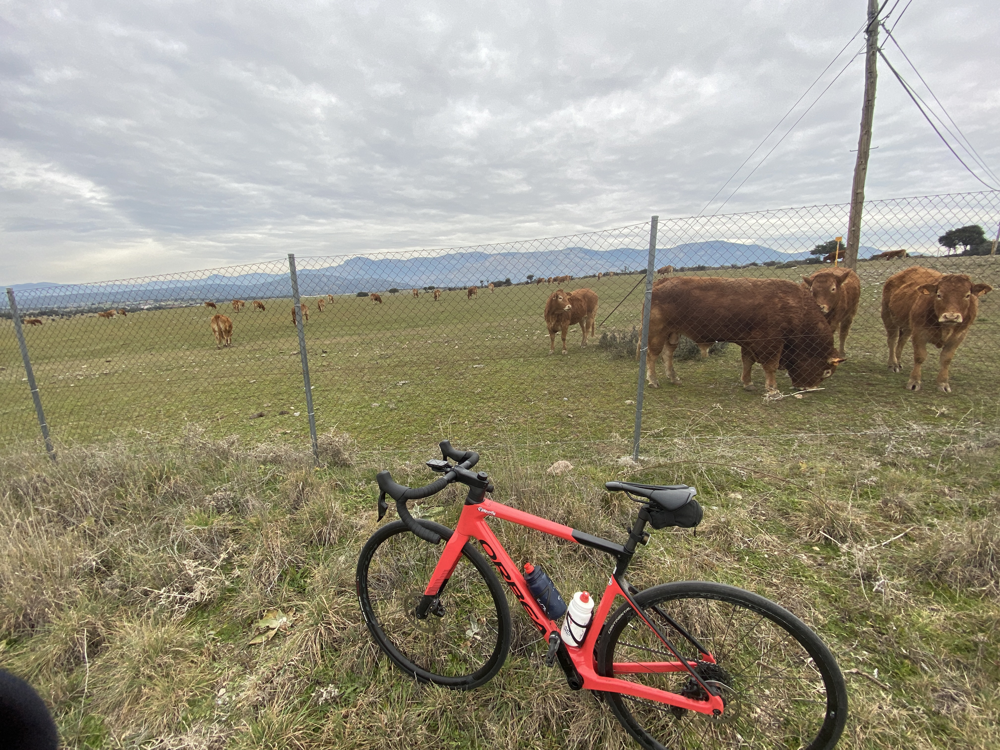

In [ ]:
random_image = random.choice(images_list)
# Function to encode the image
def encode_image(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode("utf-8")

# Path to your image
image_path = f'{imgs_path}/{random_image}'
# Getting the base64 string
base64_image = encode_image(image_path)
im  = Image.open(image_path)
display_settings = {"image/png": {"width": 700}}
display(im, metadata=display_settings)

In [13]:
client = OpenAI(api_key=openai_api_key)
response = client.chat.completions.create(
    model="gpt-4o-mini",
    messages=[
        {
            "role": "user",
            "content": [
                {
                    "type": "text",
                    "text": "Write an alt text for this image",
                },
                {
                    "type": "image_url",
                    "image_url": {"url": f"data:image/jpeg;base64,{base64_image}"},
                },
            ],
        }
    ],
)

print(response.choices[0])
print(response.choices[0].message.content)

Choice(finish_reason='stop', index=0, logprobs=None, message=ChatCompletionMessage(content='A red bicycle is leaning against a fence in the foreground, with several brown cows grazing in a field behind the fence. The sky is overcast, and mountains are visible in the distance. The scene conveys a rural landscape with grassy fields and the presence of livestock.', refusal=None, role='assistant', audio=None, function_call=None, tool_calls=None, annotations=[]))
A red bicycle is leaning against a fence in the foreground, with several brown cows grazing in a field behind the fence. The sky is overcast, and mountains are visible in the distance. The scene conveys a rural landscape with grassy fields and the presence of livestock.


A close-up view of a bicycle's handlebars overlooking a calm lake, with mountains in the background under a clear blue
sky. The bike's computer is visible on the handlebars. The scene captures a peaceful outdoor setting, with greenery
along the shoreline and a road beside the lake.


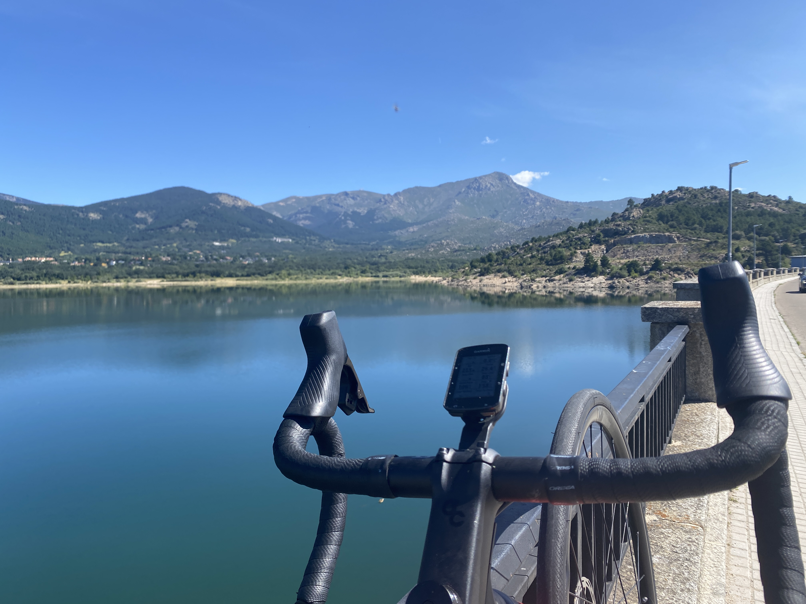

In [110]:
random_image = random.choice(images_list)
# Function to encode the image
def encode_image(image_path):
    with open(image_path, "rb") as image_file:
        return base64.b64encode(image_file.read()).decode("utf-8")

# Path to your image
image_path = f'{imgs_path}/{random_image}'
# Getting the base64 string
base64_image = encode_image(image_path)
im  = Image.open(image_path)

client = OpenAI(api_key=openai_api_key)
response = client.chat.completions.create(
    model="gpt-4o-mini",
    messages=[
        {
            "role": "user",
            "content": [
                {
                    "type": "text",
                    "text": "Write an alt text for this image",
                },
                {
                    "type": "image_url",
                    "image_url": {"url": f"data:image/jpeg;base64,{base64_image}"},
                },
            ],
        }
    ],
)

wrapped_content = textwrap.fill(response.choices[0].message.content, width=120)
print(wrapped_content)

im_small = im.resize((im.width // 5, im.height // 5))
display_settings = {"image/png": {"width": 500}}
display(im_small, metadata=display_settings)